In [1]:
import math
import numpy as np
import codecs, json 
import cv2
from tensorflow.keras.datasets import mnist
import matplotlib.pyplot as plt
from sklearn import mixture
from scipy import linalg as la

In [2]:
file_path = "hour.json"
obj_text = codecs.open(file_path, 'r', encoding='utf-8').read()
arr_list= json.loads(obj_text)
arr = np.array(arr_list)

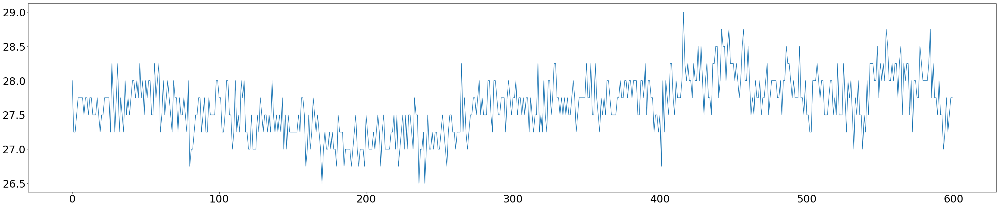

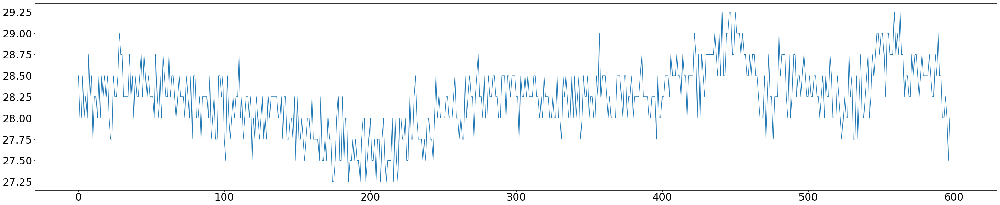

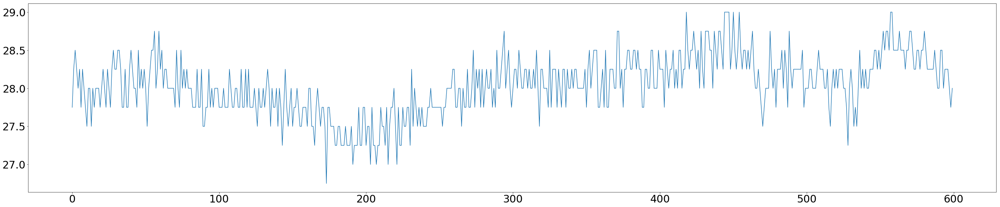

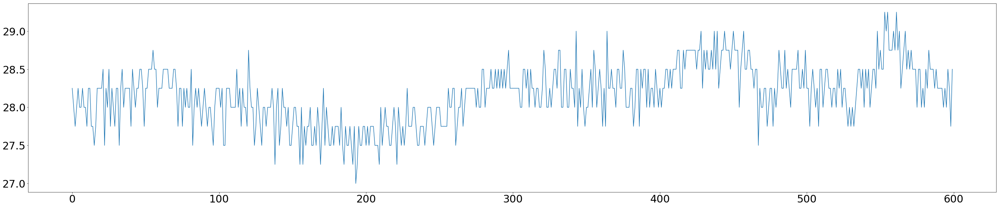

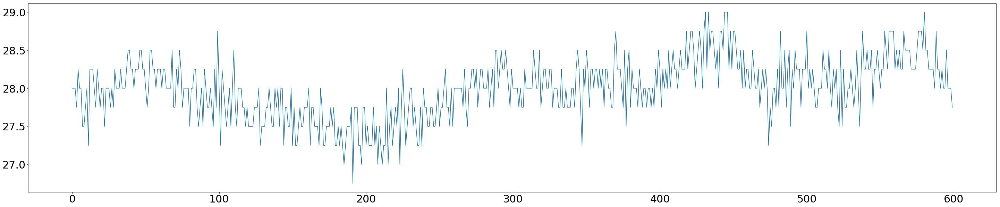

...

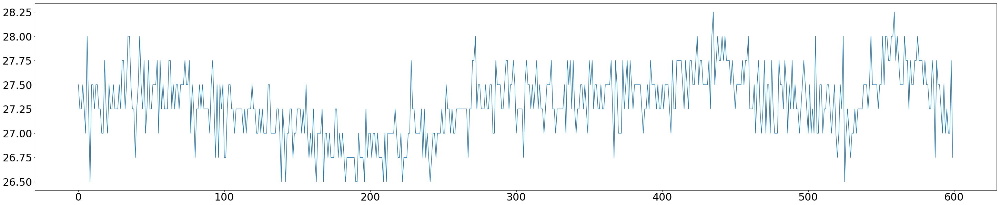

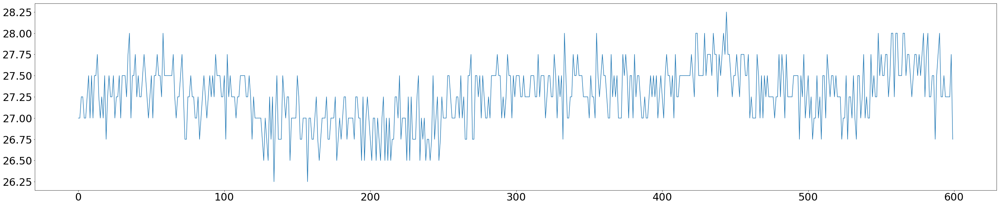

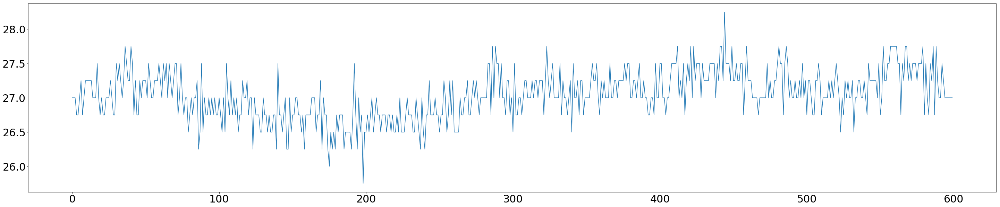

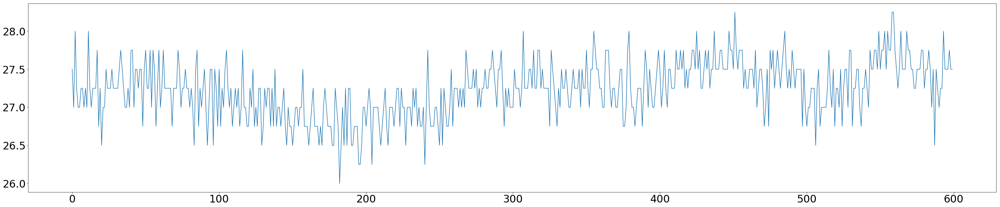

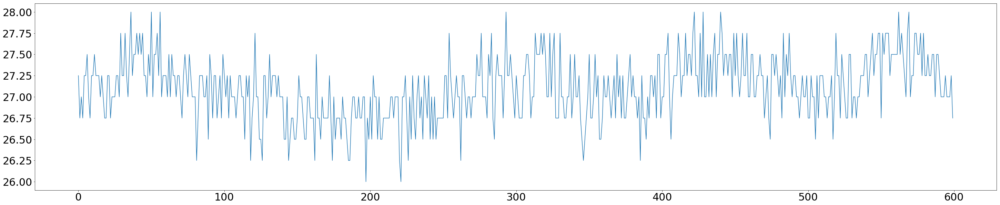

In [3]:
# plt.figure(figsize=(50, 10))
# plt.rc('xtick', labelsize=30) 
# plt.rc('ytick', labelsize=30)
# plt.figure(figsize=(50, 10))
# plt.rc('xtick', labelsize=30) 
# plt.rc('ytick', labelsize=30) 
# plt.plot(arr[:,0,0])
# plt.show()
for i in range(8):
    for j in range(8):
        plt.figure(figsize=(50, 10))
        plt.rc('xtick', labelsize=30) 
        plt.rc('ytick', labelsize=30) 
        plt.plot(arr[:600,i,j])
        plt.show()

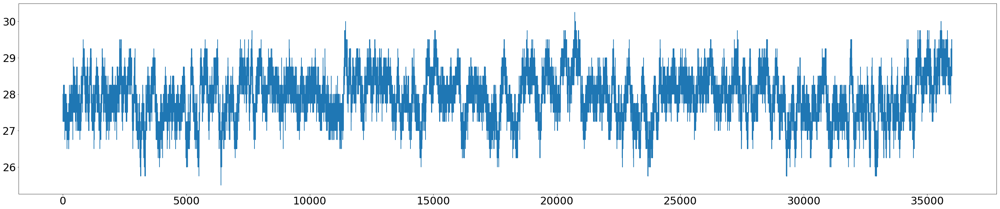

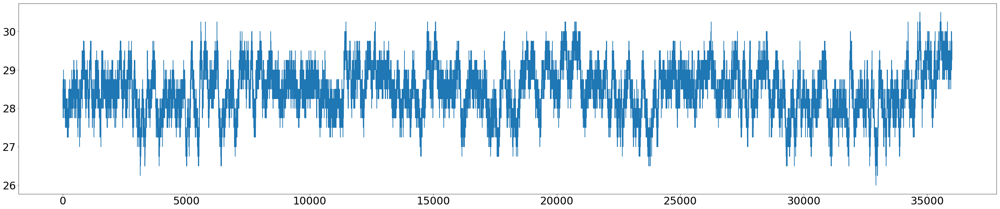

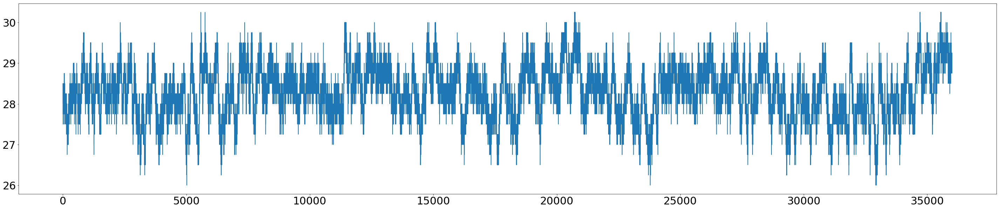

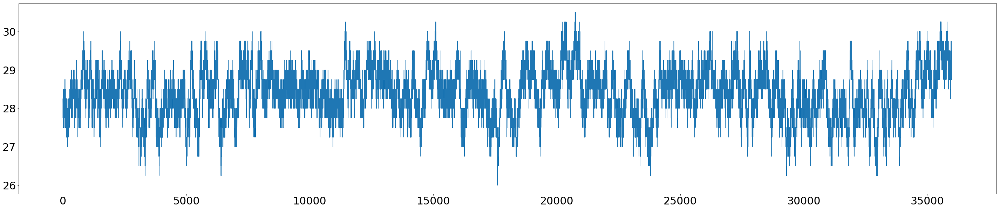

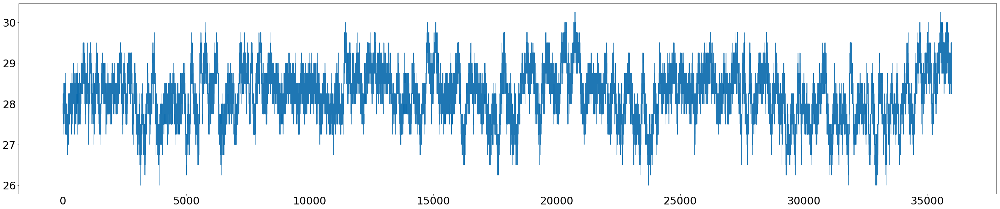

...

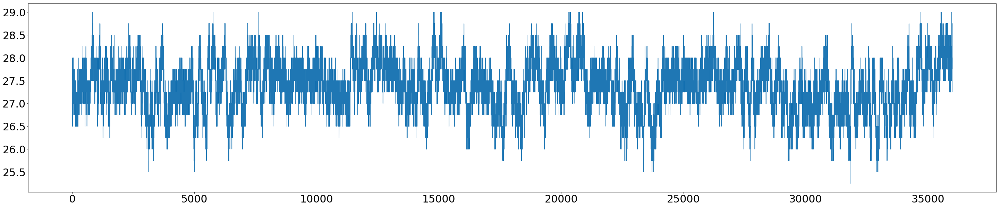

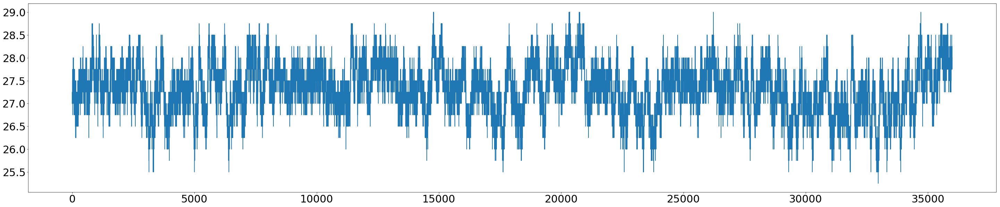

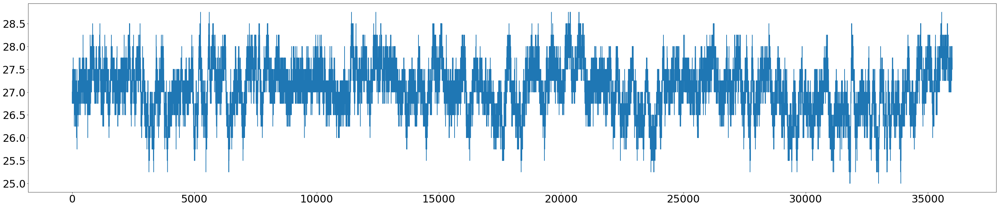

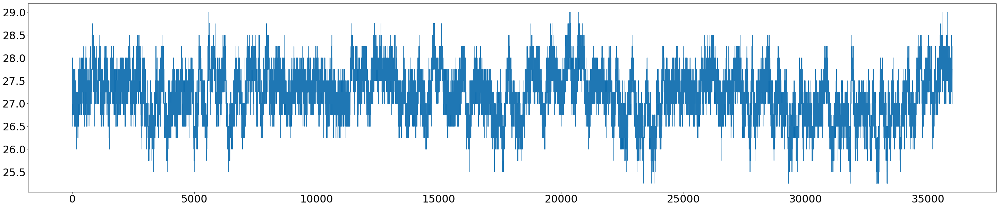

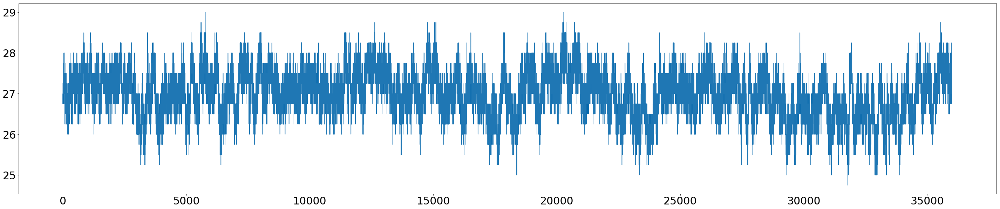

In [4]:
for i in range(8):
    for j in range(8):
        plt.figure(figsize=(50, 10))
        plt.rc('xtick', labelsize=30) 
        plt.rc('ytick', labelsize=30) 
        plt.plot(arr[:,i,j])
        plt.show()

In [3]:
arr_ave = np.reshape(arr,(-1,1))

In [41]:
arr2 = np.transpose(arr,(1,2,0))
size = 600
arr_mean = np.transpose(np.mean(np.reshape(arr2,(8,8,-1,size)),axis=3),(2,0,1))
arr_max = np.transpose(np.amax(np.reshape(arr2,(8,8,-1,size)),axis=3),(2,0,1))
arr_min = np.transpose(np.amin(np.reshape(arr2,(8,8,-1,size)),axis=3),(2,0,1))
arr_mean.shape

(60, 8, 8)

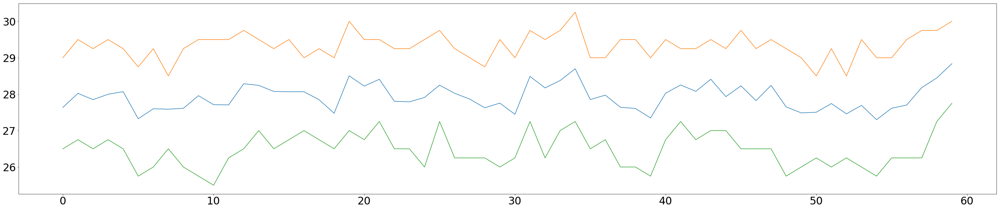

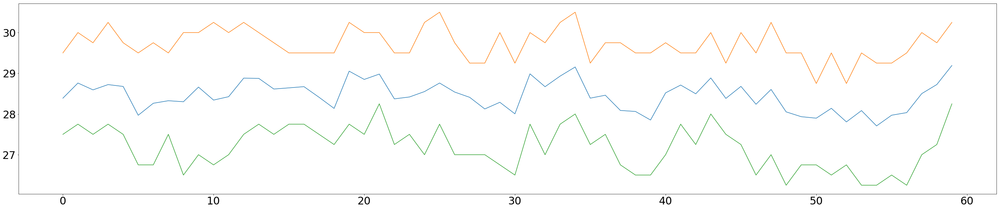

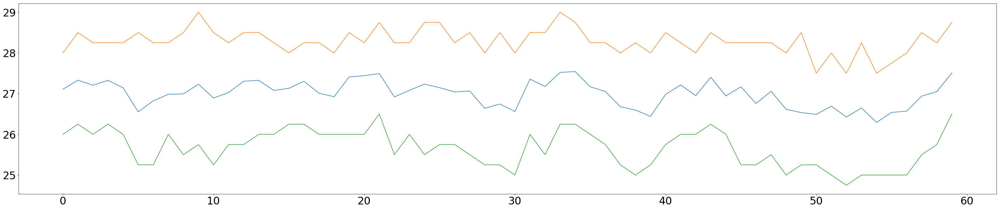

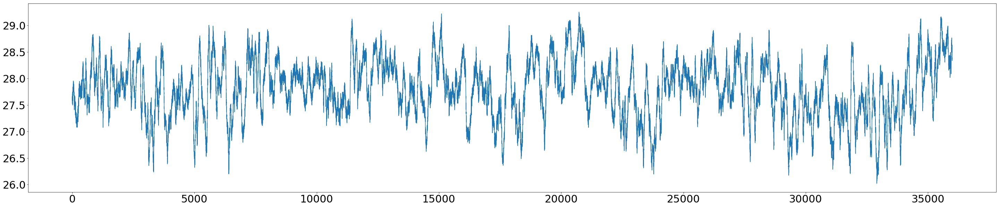

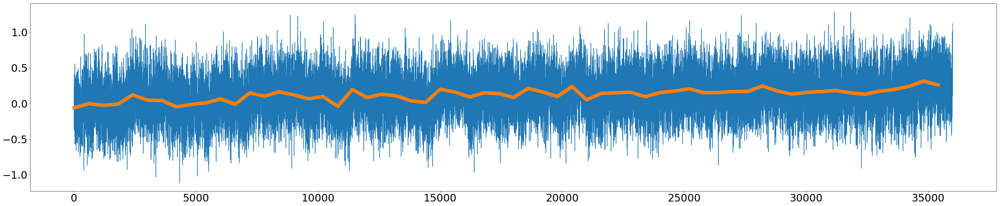

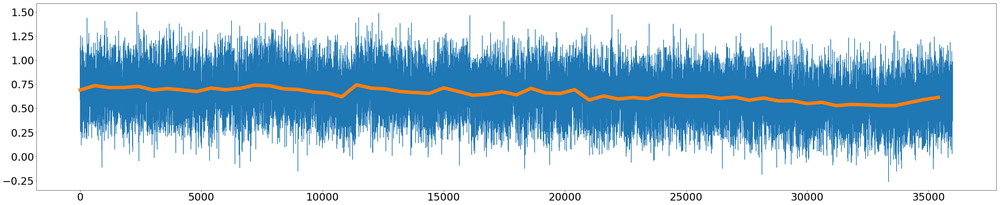

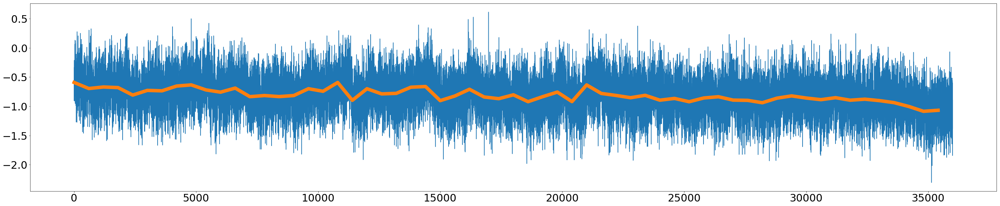

In [67]:
_x = 0
_y = 0
plt.figure(figsize=(50, 10))
plt.rc('xtick', labelsize=30) 
plt.rc('ytick', labelsize=30) 
plt.plot(arr_mean[:,_x,_y])
plt.plot(arr_max[:,_x,_y])
plt.plot(arr_min[:,_x,_y])
plt.show()
# plt.figure(figsize=(50, 10))
# plt.rc('xtick', labelsize=30) 
# plt.rc('ytick', labelsize=30) 
# plt.plot(arr_max[:,_x,_y] - arr_min[:,_x,_y])
# plt.show()
_x = 3
_y = 3
plt.figure(figsize=(50, 10))
plt.rc('xtick', labelsize=30) 
plt.rc('ytick', labelsize=30) 
plt.plot(arr_mean[:,_x,_y])
plt.plot(arr_max[:,_x,_y])
plt.plot(arr_min[:,_x,_y])
plt.show()
# plt.figure(figsize=(50, 10))
# plt.rc('xtick', labelsize=30) 
# plt.rc('ytick', labelsize=30) 
# plt.plot(arr_max[:,_x,_y] - arr_min[:,_x,_y])
# plt.show()
_x = 7
_y = 7
plt.figure(figsize=(50, 10))
plt.rc('xtick', labelsize=30) 
plt.rc('ytick', labelsize=30) 
plt.plot(arr_mean[:,_x,_y])
plt.plot(arr_max[:,_x,_y])
plt.plot(arr_min[:,_x,_y])
plt.show()
# plt.figure(figsize=(50, 10))
# plt.rc('xtick', labelsize=30) 
# plt.rc('ytick', labelsize=30) 
# plt.plot(arr_max[:,_x,_y] - arr_min[:,_x,_y])
# plt.show()

plt.figure(figsize=(50, 10))
plt.rc('xtick', labelsize=30) 
plt.rc('ytick', labelsize=30) 
plt.plot(np.mean(np.reshape(arr,(-1,64)),axis = 1))
plt.show()

plt.figure(figsize=(50, 10))
plt.rc('xtick', labelsize=30) 
plt.rc('ytick', labelsize=30) 
plt.plot(arr[:,0,0]-np.mean(np.reshape(arr,(-1,64)),axis = 1))
plt.plot(np.arange(0,36000,600),
         np.mean(np.reshape((arr[:,0,0]-np.mean(np.reshape(arr,(-1,64)),axis = 1)),(-1,size)),axis=1),
         lw = 10)
plt.show()

plt.figure(figsize=(50, 10))
plt.rc('xtick', labelsize=30) 
plt.rc('ytick', labelsize=30) 
plt.plot(arr[:,3,3]-np.mean(np.reshape(arr,(-1,64)),axis = 1))
plt.plot(np.arange(0,36000,600),
         np.mean(np.reshape((arr[:,3,3]-np.mean(np.reshape(arr,(-1,64)),axis = 1)),(-1,size)),axis=1),
         lw = 10)

plt.show()
plt.figure(figsize=(50, 10))
plt.rc('xtick', labelsize=30) 
plt.rc('ytick', labelsize=30) 
plt.plot(arr[:,7,7]-np.mean(np.reshape(arr,(-1,64)),axis = 1))
plt.plot(np.arange(0,36000,600),
         np.mean(np.reshape((arr[:,7,7]-np.mean(np.reshape(arr,(-1,64)),axis = 1)),(-1,size)),axis=1),
         lw = 10)
plt.show()

In [68]:
path = '1.txt'
arr1 = np.zeros([100,8,8])
with open(path) as f:
    for k in range(100):
        for i in range(8):
            line = f.readline()
            t = [float(x) for x in line.split()]
            arr1[k,i] = t
        line = f.readline()

In [69]:
arr1[99]

array([[28.75, 30.  , 31.5 , 31.5 , 31.75, 31.75, 31.25, 29.  ],
       [29.  , 31.  , 31.75, 31.5 , 31.75, 31.25, 30.75, 29.25],
       [29.25, 31.25, 32.25, 33.  , 32.5 , 31.75, 31.25, 28.5 ],
       [29.25, 30.75, 32.25, 32.5 , 32.25, 32.25, 31.25, 28.75],
       [29.  , 30.25, 31.5 , 32.  , 32.  , 31.75, 30.  , 28.5 ],
       [28.75, 29.25, 31.5 , 32.25, 32.  , 31.5 , 30.  , 30.  ],
       [28.75, 30.75, 31.5 , 31.5 , 31.75, 31.75, 31.5 , 30.75],
       [28.5 , 30.  , 30.75, 31.25, 31.  , 30.75, 31.25, 30.5 ]])

In [70]:
deconv = np.zeros([8,8,8,8])
s = 0.55
for i in range(8):
    for j in range(8):
        weight = 0
        for m in range(8):
            for n in range(8):
                deconv[i,j,m,n] = math.exp(-math.pow(np.linalg.norm(np.array([i,j]-np.array([m,n])))/s,2)*0.5)
                weight += deconv[i,j,m,n]
        deconv[i,j] /= weight

In [71]:
deconv = np.reshape(deconv,(64,64))
samp = np.reshape(np.mean(arr1,axis = 0),(64))
# samp = np.ones(64)*27
# samp[0:8] = 0
ans = np.linalg.solve(deconv,samp)

In [72]:
np.set_printoptions(precision=2, suppress=True)
np.reshape(ans,(8,8))

array([[28.38, 29.33, 30.77, 31.17, 31.13, 31.3 , 31.24, 28.78],
       [28.28, 30.88, 31.96, 31.05, 31.14, 30.97, 30.59, 28.25],
       [28.23, 31.38, 31.61, 32.51, 32.16, 31.24, 30.93, 28.83],
       [28.75, 30.23, 32.17, 32.33, 31.76, 31.89, 31.9 , 27.61],
       [28.28, 30.03, 31.63, 31.46, 31.58, 31.62, 29.69, 27.63],
       [28.5 , 28.36, 31.4 , 31.89, 31.19, 31.4 , 29.43, 29.99],
       [27.73, 31.72, 31.28, 31.09, 31.44, 31.51, 31.95, 30.38],
       [27.79, 29.06, 30.62, 30.88, 30.9 , 30.51, 31.  , 30.07]])

In [73]:
np.reshape(ans,(8,8))-np.reshape(samp,(8,8))

array([[-0.18, -0.27, -0.03,  0.05, -0.02,  0.09,  0.43, -0.31],
       [-0.41,  0.34,  0.42, -0.29, -0.11, -0.07,  0.14, -0.53],
       [-0.54,  0.54, -0.12,  0.35,  0.25, -0.11,  0.21, -0.14],
       [-0.15, -0.12,  0.36,  0.19, -0.09,  0.17,  0.91, -0.77],
       [-0.33,  0.15,  0.22, -0.17,  0.01,  0.24, -0.23, -0.65],
       [ 0.02, -0.93,  0.27,  0.27, -0.17,  0.2 , -0.6 ,  0.26],
       [-0.61,  1.21,  0.13, -0.11,  0.13,  0.15,  0.66, -0.09],
       [-0.27, -0.36,  0.04, -0.02, -0.03, -0.27,  0.06, -0.22]])

In [74]:
np.reshape(samp,(8,8))

array([[28.57, 29.61, 30.79, 31.12, 31.15, 31.21, 30.81, 29.09],
       [28.68, 30.54, 31.54, 31.33, 31.25, 31.04, 30.45, 28.78],
       [28.77, 30.84, 31.73, 32.16, 31.91, 31.34, 30.72, 28.98],
       [28.89, 30.35, 31.81, 32.14, 31.85, 31.72, 30.99, 28.38],
       [28.61, 29.89, 31.41, 31.63, 31.57, 31.38, 29.91, 28.28],
       [28.48, 29.29, 31.13, 31.61, 31.36, 31.2 , 30.03, 29.74],
       [28.34, 30.51, 31.16, 31.2 , 31.31, 31.37, 31.29, 30.48],
       [28.06, 29.42, 30.58, 30.9 , 30.93, 30.78, 30.94, 30.28]])

In [39]:
for i in range(64):
    print(i)
    print(np.reshape(deconv[i], (8,8)).round(3))




0
[[0.7  0.14 0.   0.   0.   0.   0.   0.  ]
 [0.14 0.03 0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]]
1
[[0.12 0.61 0.12 0.   0.   0.   0.   0.  ]
 [0.02 0.12 0.02 0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]]
2
[[0.   0.12 0.6  0.12 0.   0.   0.   0.  ]
 [0.   0.02 0.12 0.02 0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0

In [68]:
pp = 0
for i in range (64):
    pp += ans[i]*deconv[2,i]
print(pp)

31.000000000000007
